Import all necessary libraries and functions, as well as the primary data-structure

In [1]:
# This builds the full data-structure, including
# 1. initial parameter and covariate sets
# 2. pre-processing settings and additional parameters-induced changes to data

%run fMRI_prestats_data-struct.ipynb

/opt/miniconda-latest/envs/neuro/lib/python3.7/site-packages/nilearn/datasets/__init__.py:90: FutureWarning: Fetchers from the nilearn.datasets module will be updated in version 0.9 to return python strings instead of bytes and Pandas dataframes instead of Numpy arrays.
  "Numpy arrays.", FutureWarning)


subject(s) missing!
First line of list-alignment:   FED006 FED006 FED007
Control relevant files!


 The following subjects where excluded from further analysis due to false file numbers or missing data:  
 EPI:  ['FED006'] T1:  ['FED006']
The new subject list after initial data and image file checkup:

['FED007', 'FED008', 'FED009', 'FED010', 'FED011', 'FED012', 'FED013', 'FED014', 'FED015', 'FED016', 'FED017', 'FED018', 'FED019', 'FED020', 'FED021', 'FED022', 'FED023', 'FED024', 'FED025', 'FED026', 'FED027', 'FED028', 'FED029', 'FED030', 'FED031', 'FED032', 'FED033', 'FED034', 'FED035', 'FED036', 'FED037', 'FED038', 'FED039', 'FED040', 'FED041', 'FED042', 'FED043', 'FED044', 'FED045', 'FED046', 'FED047', 'FED048', 'FED049', 'FED050', 'FED051', 'FED052', 'FED053', 'FED054', 'FED055', 'FED056', 'FED057', 'FED058', 'FED059', 'FED060', 'FED061', 'FED062', 'FED063', 'FED064', 'FED065', 'FED066', 'FED067', 'FED068']


That leaves a total of  62 remaining subjects.


The following parameters

In [2]:
# Delete all variables in the current namespace from globals except those defined at the initiation of the data structure
for var in dir():
    if (var != 'data_varspace_init' and var not in data_varspace_init):
        #print(var, " will be deleted from this notebook's global namespace")
        del globals()[var]

In [3]:
# control results
key = random.sample(data.keys(), 1)
print(data[key[0]])
print(data["general"])

{'files': ['/fMRI/FED017/FMRI.json', '/fMRI/FED017/FMRI.nii.gz', '/fMRI/FED017/FMRI_mc-bet.nii.gz', '/fMRI/FED017/FMRI_mc.nii.gz', '/fMRI/FED017/FMRI_mc_mask.nii.gz', '/fMRI/FED017/FMRI_mc_mean.nii.gz', '/fMRI/FED017/FMRI_mc_overlay.nii.gz', '/fMRI/FED017/GM_cr_mask.nii.gz', '/fMRI/FED017/GM_cr_wholebrain.nii.gz', '/fMRI/FED017/T1_BETBf35.nii', '/fMRI/FED017/T1_BETBf35_mask.nii', '/fMRI/FED017/T1_BETBf35_overlay.nii', '/fMRI/FED017/T1_GM-tpm_mask.nii.gz', '/fMRI/FED017/T1_MPRAGE.json', '/fMRI/FED017/T1_MPRAGE.nii.gz', '/fMRI/FED017/T1_WM-tpm_mask.nii.gz', '/VBM/FED017/DARTEL_newsegment/c1CON_FED017_T1_MPRAGE_SAG_ISO_0_9_0005_20141204151043.nii', '/VBM/FED017/DARTEL_newsegment/c2CON_FED017_T1_MPRAGE_SAG_ISO_0_9_0005_20141204151043.nii', '/fMRI/FED017/FMRI_mc-bet.nii.gz_cr-matrix', '/fMRI/FED017/FMRI_mc.nii.gz.par'], 'parameters': {'T1_ET': 0.00232, 'T1_RT': 2.3, 'T1_PES': 255, 'T1_IT': 0.9, 'T1_PB': 200, 'EPI_ET': 25.0, 'EPI_RT': 1.8, 'EPI_ETL': 33, 'EPI_PES': 67, 'EPI_PED': 'y-', 'EPI_

# Preprocessing

In [4]:
# (Re-)activate nipype-workflows output, as we want to see what's going on
logging.getLogger('nipype.interface').setLevel("WARNING")

In [5]:
# set default data ouput for all FSL operations
fsl.FSLCommand.set_default_output_type('NIFTI_GZ')

Brain extraction (structural)

In [6]:
# prepare the structural scans
# for usage in motion correction, normalisation etc.
structs = [i for sub in FEDs
           for i in data[sub]["files"]
           if re.match(r'.*(T1).*.nii.gz', i)]

# try different bets, starting with fsl_vbm parameters from custom bash script first
#fracs=["0."+str(i) for i in np.arange(20,80,5)]
# after visual inspection:
frac = "0.35"

# perform brain extraction
for file in structs:
    bet = pe.Node(fsl.BET(), name="bet")
    bet.inputs.in_file=file
    bet.inputs.out_file = f"{file.split('_', 1)[0]}_BETBf{str(frac[2:])}.nii"
    bet.inputs.outline = True
    bet.inputs.reduce_bias = True
    bet.inputs.frac = float(frac)
    bet.inputs.output_type = "NIFTI"
    # run it
    res = bet.run()
    # print the results
    print(res.outputs)

# update files
update_files(collect_files())

210420-07:39:08,378 nipype.workflow INFO:
	 [Node] Setting-up "bet" in "/tmp/tmpk62gtezt/bet".
210420-07:39:08,382 nipype.workflow INFO:
	 [Node] Running "bet" ("nipype.interfaces.fsl.preprocess.BET"), a CommandLine Interface with command:
bet /fMRI/FED065/T1_MPRAGE.nii.gz /fMRI/FED065/T1_BETBf35.nii -f 0.35 -o -B
210420-07:46:51,211 nipype.workflow INFO:
	 [Node] Finished "bet".

inskull_mask_file = <undefined>
inskull_mesh_file = <undefined>
mask_file = /fMRI/FED065/T1_BETBf35_mask.nii
meshfile = <undefined>
out_file = /fMRI/FED065/T1_BETBf35.nii
outline_file = /fMRI/FED065/T1_BETBf35_overlay.nii
outskin_mask_file = <undefined>
outskin_mesh_file = <undefined>
outskull_mask_file = <undefined>
outskull_mesh_file = <undefined>
skull_file = <undefined>
skull_mask_file = <undefined>

210420-07:46:51,213 nipype.workflow INFO:
	 [Node] Setting-up "bet" in "/tmp/tmpwyd1l4ua/bet".
210420-07:46:51,217 nipype.workflow INFO:
	 [Node] Running "bet" ("nipype.interfaces.fsl.preprocess.BET"), a Comm

62


/opt/miniconda-latest/envs/neuro/lib/python3.7/site-packages/nilearn/image/resampling.py:527: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/opt/miniconda-latest/envs/neuro/lib/python3.7/site-packages/nilearn/image/resampling.py:527: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/opt/miniconda-latest/envs/neuro/lib/python3.7/site-packages/nilearn/image/resampling.py:527: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/opt/miniconda-latest/envs/neuro/lib/python3.7/site-packages/nilearn/image/resampling.py:527: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/opt/miniconda-latest/envs/neuro/lib/python3.7/site-packages/nilearn/image/resampling.py:527: UserWarning: Casting data from int32 to float32
  warn

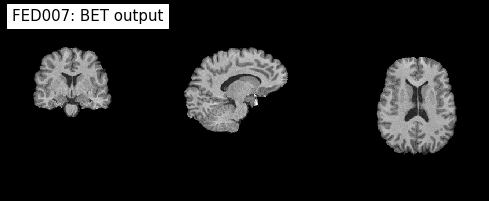

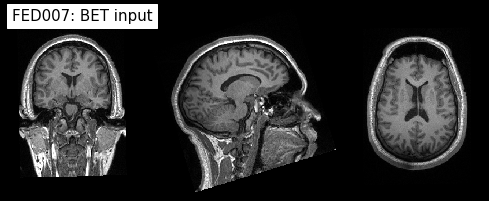

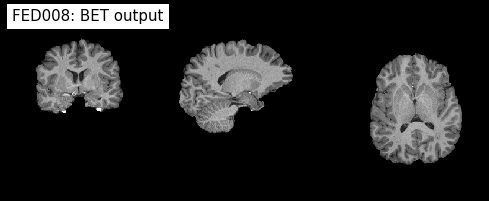

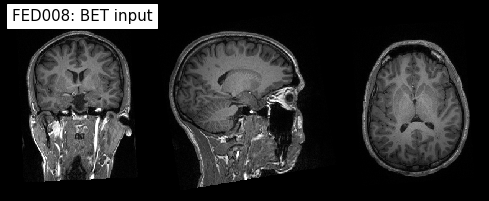

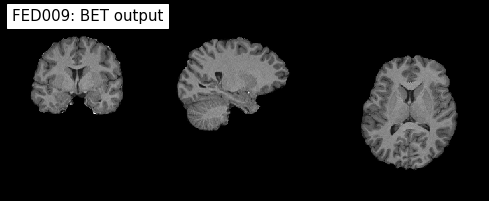

...

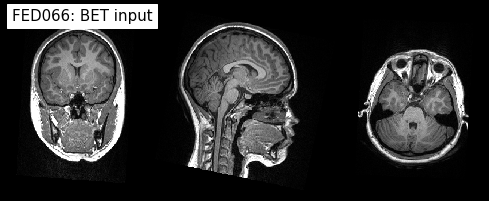

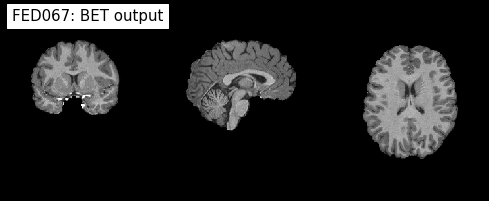

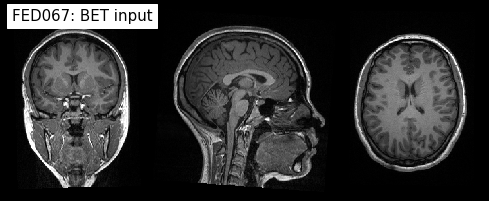

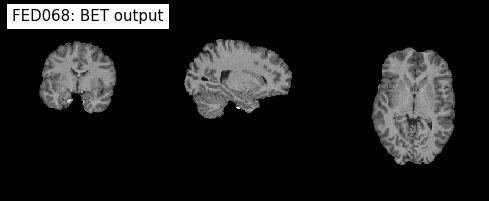

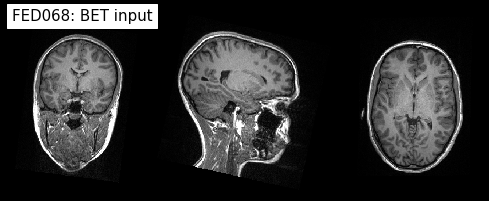

In [8]:
# control number of brain-extracted files
structs_bet = sorted([file for sub in FEDs
                      for file in data[sub]["files"]
                      if re.match(r'.*T1_BET.*(?<!overlay)(?<!mask).nii', file)])

# control the file list
print(len(structs_bet))

# plot before-after comparison of BET
for sub in FEDs:
    for file in data[sub]["files"]:
        if re.match(r'.*(T1).*.nii.gz', file):
            ni_plt.plot_anat(file, title=f'{sub}: BET input', cut_coords=(10,10,10), display_mode='ortho',
                      dim=-1, draw_cross=False, annotate=False);
        elif re.match(r'.*(T1_BET).*(?<!overlay)(?<!mask).nii', file):
            ni_plt.plot_anat(file, title=f'{sub}: BET output', cut_coords=(10,10,10), display_mode='ortho',
                      dim=-1, draw_cross=False, annotate=False);

MCFLIRT for motion correction / realignment

In [ ]:
# define list of raw functional images to gunzip them for better processing via SPM etc.^^
raws = sorted([i for sub in FEDs
               for i in data[sub]["files"]
               if re.match(r'.*(FMRI).*.nii.gz', i)])

In [ ]:
%%script env RAW_FUNCS="$raws" bash
# transfer functionals to bash array and get rid of list/string characters
RAW_FUNC_arr=($(echo $RAW_FUNCS | sed -e 's/[][]//g' -e 's/,//g' -e "s/'//g"))

# gzip each functional file
for file in "${RAW_FUNC_arr[@]}"; do
gunzip $file
done

In [6]:
# define a function to get the index of the middle volume of a functional dataset
def getmiddlevolume_index(func):
    funcfile = func
    if isinstance(func, list):
        funcfile = func[0]
    _, _, _, timepoints = nb.load(funcfile).shape
    return int(timepoints / 2)  # int()rounds down

In [7]:
# MCFLIRT (6DFs) Motion correction -- 6 regressors in Level1 Model
# define input files
raws = sorted([i for sub in FEDs
               for i in data[sub]["files"]
               if re.match(r'.*(FMRI).*.nii.gz', i)])

# set up MCFLIRT node (parameters are based on simulation results -> Drobnjak thesis)
for img in raws:
    # set up node to extract the middle volume of a subject as reference for MCFLIRT
    middle_ref = pe.Node(fsl.ExtractROI(), name='middle_ref')
    middle_ref.inputs.in_file = img
    middle_ref.inputs.t_size = 1
    middle_ref.inputs.t_min = getmiddlevolume_index(img)
#    middle_ref.inputs.roi_file= f"{img.rsplit('.',2)[0]}_midvol.nii.gz"
    # run it
    res1 = middle_ref.run()
    # set up MCFLIRT node (parameters are based on simulation results -> Drobnjak thesis)
    mcflirt = pe.Node(fsl.MCFLIRT(), name="mcflirt")
    mcflirt.inputs.in_file = img
    mcflirt.inputs.cost = "normcorr"
    mcflirt.inputs.save_plots = True
    mcflirt.inputs.stages = 4
    mcflirt.inputs.ref_file = res1.outputs.roi_file
    mcflirt.inputs.out_file = f"{img.rsplit('.',2)[0]}_mc.nii.gz"
    # run it
    res2 = mcflirt.run()
    # print the results
    print(res2.outputs)

# update files
update_files(collect_files())

210420-09:08:20,182 nipype.workflow INFO:
	 [Node] Setting-up "middle_ref" in "/tmp/tmp84i8hcly/middle_ref".
210420-09:08:20,185 nipype.workflow INFO:
	 [Node] Running "middle_ref" ("nipype.interfaces.fsl.utils.ExtractROI"), a CommandLine Interface with command:
fslroi /fMRI/FED007/FMRI.nii.gz /tmp/tmp84i8hcly/middle_ref/FMRI_roi.nii.gz 131 1
210420-09:08:21,53 nipype.workflow INFO:
	 [Node] Finished "middle_ref".
210420-09:08:21,55 nipype.workflow INFO:
	 [Node] Setting-up "mcflirt" in "/tmp/tmpf6nlspk4/mcflirt".
210420-09:08:21,59 nipype.workflow INFO:
	 [Node] Running "mcflirt" ("nipype.interfaces.fsl.preprocess.MCFLIRT"), a CommandLine Interface with command:
mcflirt -in /fMRI/FED007/FMRI.nii.gz -cost normcorr -out /fMRI/FED007/FMRI_mc.nii.gz -reffile /tmp/tmp84i8hcly/middle_ref/FMRI_roi.nii.gz -plots -stages 4
210420-09:15:10,961 nipype.workflow INFO:
	 [Node] Finished "mcflirt".

mat_file = <undefined>
mean_img = <undefined>
out_file = /fMRI/FED007/FMRI_mc.nii.gz
par_file = /fMRI

Visually inspect the motion parameters per subject

In [8]:
# plot the estimated motion parameters (MCFLIRT parameter output)
# define input files
mcorrs = sorted([i for sub in FEDs
                 for i in data[sub]["files"]
                 if re.match(r'.*(FMRI).*(?<=mc).nii.gz$', i)])

# set up plotting node
for i in mcorrs:
    plotmotion = pe.Node(fsl.PlotMotionParams(), name='plotmotion')
    plotmotion.inputs.in_file = f"{i}.par"
    plotmotion.inputs.in_source = 'fsl'
    plotmotion.inputs.plot_type = 'displacement'
    # run it
    res = plotmotion.run()
    # print the results
    print(res.outputs)

# update files
update_files(collect_files())

210420-17:45:51,379 nipype.workflow INFO:
	 [Node] Setting-up "plotmotion" in "/tmp/tmp1n7fnjub/plotmotion".
210420-17:45:51,384 nipype.workflow INFO:
	 [Node] Running "plotmotion" ("nipype.interfaces.fsl.utils.PlotMotionParams"), a CommandLine Interface with command:
fsl_tsplot -i /fMRI/FED007/FMRI_mc.nii.gz.par -o /fMRI/FED007/FMRI_mc.nii.gz_disp.png -t 'MCFLIRT estimated mean displacement (mm)' -a abs,rel
210420-17:45:51,578 nipype.workflow INFO:
	 [Node] Finished "plotmotion".

out_file = /fMRI/FED007/FMRI_mc.nii.gz_disp.png

210420-17:45:51,580 nipype.workflow INFO:
	 [Node] Setting-up "plotmotion" in "/tmp/tmp9v8y5qhi/plotmotion".
210420-17:45:51,585 nipype.workflow INFO:
	 [Node] Running "plotmotion" ("nipype.interfaces.fsl.utils.PlotMotionParams"), a CommandLine Interface with command:
fsl_tsplot -i /fMRI/FED008/FMRI_mc.nii.gz.par -o /fMRI/FED008/FMRI_mc.nii.gz_disp.png -t 'MCFLIRT estimated mean displacement (mm)' -a abs,rel
210420-17:45:51,758 nipype.workflow INFO:
	 [Node] F

In [9]:
# define motion parameter images [Currrently not included in update_files(collect_files()) ... add if needed^^]
motpar_png = sorted([i for sub in FEDs
                     for i in data[sub]["files"]
                     if re.match(r'.*(FMRI).*(?<=gz_disp).png', i)])

# print png files for the first seven subjects
for i in motpar_png[0:7]:
    mpar = mpl_img.imread(i)
    fig, ax = plt.subplots()
    plt.title(f"{i.split('/',3)[2]} mean displacement (mm):")
    plt.imshow(mpar)

In [9]:
# OPTIONAL!:
# Motion_outliers (extreme outliers) -- 1 regressor/outlier(might not all have the same effect^^) in Level1 Model

# set up MELODIC node
for i in mcorrs:
    mot_outlier = pe.Node(fsl.MotionOutliers(), name="mot_outlier")
    mot_outlier.inputs.in_file = i
    mot_outlier.inputs.no_motion_correction = True
    mot_outlier.inputs.out_file = f"{i[:-4]}_outliers.txt"
    mot_outlier.inputs.out_metric_values = f"{i[:-4]}_metrics.txt"
    mot_outlier.inputs.out_metric_plot = f"{i[:-4]}_metrics.png"
    # run it
    res = mot_outlier.run()
    # print the results
    print(res.outputs)

# update files
update_files(collect_files())

# -> use rapidart as an alternative means for artefact correction at the very end of the preprocessing workflow -> FSLrec

201103-12:29:30,785 nipype.workflow INFO:
	 [Node] Setting-up "mot_outlier" in "/tmp/tmpvt3030fk/mot_outlier".
201103-12:29:30,788 nipype.workflow INFO:
	 [Node] Running "mot_outlier" ("nipype.interfaces.fsl.utils.MotionOutliers"), a CommandLine Interface with command:
fsl_motion_outliers -i /fMRI/FED007/FMRI_motcor_6reg.nii.gz --nomoco -o /fMRI/FED007/FMRI_motcor_6reg.ni_outliers.txt -p /fMRI/FED007/FMRI_motcor_6reg.ni_metrics.png -s /fMRI/FED007/FMRI_motcor_6reg.ni_metrics.txt
201103-12:29:48,175 nipype.workflow INFO:
	 [Node] Finished "mot_outlier".

out_file = /fMRI/FED007/FMRI_motcor_6reg.ni_outliers.txt
out_metric_plot = /fMRI/FED007/FMRI_motcor_6reg.ni_metrics.png
out_metric_values = /fMRI/FED007/FMRI_motcor_6reg.ni_metrics.txt

201103-12:29:48,178 nipype.workflow INFO:
	 [Node] Setting-up "mot_outlier" in "/tmp/tmp0q2qcznt/mot_outlier".
201103-12:29:48,182 nipype.workflow INFO:
	 [Node] Running "mot_outlier" ("nipype.interfaces.fsl.utils.MotionOutliers"), a CommandLine Interfac

Rapidart Artifact Detection (ART)

In [20]:
# set up artifact detection for original motion corrected images (other preprocessing might distort it ^^)
# define input files
motpars = sorted([i for sub in FEDs
                 for i in data[sub]["files"]
                 if re.match(r'.*(FMRI).*(?<=mc).nii.gz.par$', i)])

for img, realignpar in zip(mcorrs, motpars):
    artdetect = pe.Node(ra.ArtifactDetect(), name="artdetect")
    artdetect.inputs.realigned_files = img
    artdetect.inputs.realignment_parameters = realignpar
    artdetect.inputs.use_differences = [True, False]
    artdetect.inputs.use_norm = True
    artdetect.inputs.norm_threshold = 1
    artdetect.inputs.zintensity_threshold = 3  # 2 SDs define outliers .....other threshold better? DerekPisner: 3
    artdetect.inputs.parameter_source = 'FSL'
    artdetect.inputs.mask_type = 'spm_global'
    artdetect.inputs.plot_type = 'svg'  # superior to png, sxtensible Markup language-based vector image
    artdetect.base_dir = img.rsplit('/', 1)[0]
    #artdetect.inputs.mask_file = mask
    # run it
    res = artdetect.run()
    # print the results
    print(res.outputs)

# update files
update_files(collect_files())

210420-17:59:22,665 nipype.workflow INFO:
	 [Node] Setting-up "artdetect" in "/fMRI/FED007/artdetect".
210420-17:59:22,671 nipype.workflow INFO:
	 [Node] Running "artdetect" ("nipype.algorithms.rapidart.ArtifactDetect")
210420-17:59:23,906 nipype.workflow INFO:
	 [Node] Finished "artdetect".

displacement_files = <undefined>
intensity_files = /fMRI/FED007/artdetect/global_intensity.FMRI_mc.txt
mask_files = /fMRI/FED007/artdetect/mask.FMRI_mc.nii.gz
norm_files = /fMRI/FED007/artdetect/norm.FMRI_mc.txt
outlier_files = /fMRI/FED007/artdetect/art.FMRI_mc_outliers.txt
plot_files = /fMRI/FED007/artdetect/plot.FMRI_mc.svg
statistic_files = /fMRI/FED007/artdetect/stats.FMRI_mc.txt

210420-17:59:23,907 nipype.workflow INFO:
	 [Node] Setting-up "artdetect" in "/fMRI/FED008/artdetect".
210420-17:59:23,910 nipype.workflow INFO:
	 [Node] Running "artdetect" ("nipype.algorithms.rapidart.ArtifactDetect")
210420-17:59:25,80 nipype.workflow INFO:
	 [Node] Finished "artdetect".

displacement_files = <un

In [1]:
# Post-ART artefact detection procedures - like subject outlier detection and removal -
# have been integrated into the data-structure ("II" - Prefix)

Slicetime correction (?)

I will omit this step as advised by Poldrack, Nichols and Mumford "Handbook of fMRI data analysis"(2011)\
TR= 1800ms  > 2seconds, interleaved acquisition and likely smoothing\
event related analysis is relatively robust to slice-timing problems here.

FSLrec: use temporal (and dispersion) derivative to model variability in onset and shape to compensate for omission here

Brain extraction (functional)

In [24]:
# calculate the mean volume for each motion corrected image
for i in mcorrs:
    meanfunc = pe.Node(fsl.maths.MeanImage(), name="meanmotion")
    meanfunc.inputs.in_file = i
    meanfunc.inputs.dimension = "T"
    meanfunc.inputs.out_file = f"{i.rsplit('.',2)[0]}_mean.nii.gz"
    # run it
    res = meanfunc.run()
    # print it
    print(res.outputs)

# update files
update_files(collect_files())

210420-18:03:03,920 nipype.workflow INFO:
	 [Node] Setting-up "meanmotion" in "/tmp/tmp_ki6ipg5/meanmotion".
210420-18:03:03,923 nipype.workflow INFO:
	 [Node] Running "meanmotion" ("nipype.interfaces.fsl.maths.MeanImage"), a CommandLine Interface with command:
fslmaths /fMRI/FED007/FMRI_mc.nii.gz -Tmean /fMRI/FED007/FMRI_mc_mean.nii.gz
210420-18:03:05,424 nipype.workflow INFO:
	 [Node] Finished "meanmotion".

out_file = /fMRI/FED007/FMRI_mc_mean.nii.gz

210420-18:03:05,427 nipype.workflow INFO:
	 [Node] Setting-up "meanmotion" in "/tmp/tmphv5007w0/meanmotion".
210420-18:03:05,431 nipype.workflow INFO:
	 [Node] Running "meanmotion" ("nipype.interfaces.fsl.maths.MeanImage"), a CommandLine Interface with command:
fslmaths /fMRI/FED008/FMRI_mc.nii.gz -Tmean /fMRI/FED008/FMRI_mc_mean.nii.gz
210420-18:03:06,981 nipype.workflow INFO:
	 [Node] Finished "meanmotion".

out_file = /fMRI/FED008/FMRI_mc_mean.nii.gz

210420-18:03:06,984 nipype.workflow INFO:
	 [Node] Setting-up "meanmotion" in "/tm

In [25]:
# strip the skull from the mean volume to generate a functional mask
# define input files
means = sorted([i for sub in FEDs
               for i in data[sub]["files"]
               if re.match(r'.*(FMRI).*(?<=mc)_mean', i)])

# define a fractional intensity for thresholding (same as in structurals here)
frac = 0.35

for i in means:
    maskstrip = pe.Node(fsl.BET(), name="maskstrip")
    maskstrip.inputs.in_file = i
    maskstrip.inputs.no_output = True
    maskstrip.inputs.outline = True
    maskstrip.inputs.mask = True
    maskstrip.inputs.out_file = f"{i.rsplit('_',1)[0]}.nii.gz"  # "_mask" suffix is affixed automatically
    maskstrip.inputs.frac = frac
    # run it
    res = maskstrip.run()
    # print the results
    print(res.outputs)

# update files
update_files(collect_files())

210420-18:06:23,928 nipype.workflow INFO:
	 [Node] Setting-up "maskstrip" in "/tmp/tmpknuah27c/maskstrip".
210420-18:06:23,931 nipype.workflow INFO:
	 [Node] Running "maskstrip" ("nipype.interfaces.fsl.preprocess.BET"), a CommandLine Interface with command:
bet /fMRI/FED007/FMRI_mc_mean.nii.gz /fMRI/FED007/FMRI_mc.nii.gz -f 0.35 -m -n -o
210420-18:06:25,40 nipype.workflow INFO:
	 [Node] Finished "maskstrip".

inskull_mask_file = <undefined>
inskull_mesh_file = <undefined>
mask_file = /fMRI/FED007/FMRI_mc_mask.nii.gz
meshfile = <undefined>
out_file = <undefined>
outline_file = /fMRI/FED007/FMRI_mc_overlay.nii.gz
outskin_mask_file = <undefined>
outskin_mesh_file = <undefined>
outskull_mask_file = <undefined>
outskull_mesh_file = <undefined>
skull_file = <undefined>
skull_mask_file = <undefined>

210420-18:06:25,44 nipype.workflow INFO:
	 [Node] Setting-up "maskstrip" in "/tmp/tmpwce1lkv5/maskstrip".
210420-18:06:25,49 nipype.workflow INFO:
	 [Node] Running "maskstrip" ("nipype.interfaces

In [13]:
# mask the functional runs with the mask
# define input files
masks = sorted([i for sub in FEDs
               for i in data[sub]["files"]
               if re.match(r'.*(FMRI).*(?<=mc)_mask', i)])

for img, mask in zip(mcorrs, masks):
    maskfunc = pe.Node(fsl.ImageMaths(), name="maskfunc")
    maskfunc.inputs.in_file = img
    maskfunc.inputs.in_file2 = mask
    maskfunc.inputs.out_file = f"{img.rsplit('.',2)[0]}-bet.nii.gz"
    maskfunc.inputs.op_string = "-mas"
    # run it
    res = maskfunc.run()
    # print the results
    print(res.outputs)

# update files
update_files(collect_files())

210421-07:49:43,856 nipype.workflow INFO:
	 [Node] Setting-up "maskfunc" in "/tmp/tmpnpe3fznw/maskfunc".
210421-07:49:43,860 nipype.workflow INFO:
	 [Node] Running "maskfunc" ("nipype.interfaces.fsl.utils.ImageMaths"), a CommandLine Interface with command:
fslmaths /fMRI/FED047/FMRI_mc.nii.gz -mas /fMRI/FED047/FMRI_mc_mask.nii.gz /fMRI/FED047/FMRI_mc-bet.nii.gz
210421-07:49:49,889 nipype.workflow INFO:
	 [Node] Finished "maskfunc".

out_file = /fMRI/FED047/FMRI_mc-bet.nii.gz

210421-07:49:49,892 nipype.workflow INFO:
	 [Node] Setting-up "maskfunc" in "/tmp/tmpvew6hzdi/maskfunc".
210421-07:49:49,897 nipype.workflow INFO:
	 [Node] Running "maskfunc" ("nipype.interfaces.fsl.utils.ImageMaths"), a CommandLine Interface with command:
fslmaths /fMRI/FED049/FMRI_mc.nii.gz -mas /fMRI/FED049/FMRI_mc_mask.nii.gz /fMRI/FED049/FMRI_mc-bet.nii.gz
210421-07:49:56,75 nipype.workflow INFO:
	 [Node] Finished "maskfunc".

out_file = /fMRI/FED049/FMRI_mc-bet.nii.gz

210421-07:49:56,77 nipype.workflow INFO

Prep: Corregistration: functional to structural

In [4]:
# use SPM's NewSegment (DARTEL) to generate White Matter Probability Maps
# 1. ALREADY DONE IN VBM: Insert VBM WM TPMs into data[sub]["files"]
# 2. Try different number of gaussians (default = 2) as shown in Michael Notter's hands-on nipype tutorial -> no major differences
# need to perform segmentation with full tissue information, or brain will be classified as "soft tissue" etc. -> see examples in "/VBM/FED006/"
TPM_file = os.path.join(tpmdir, "TPM.nii")
tissue1 = ((TPM_file, 1), 2, (True, False), (False, False))  # GM
tissue2 = ((TPM_file, 2), 2, (True, False), (False, False))   # WM
tissue3 = ((TPM_file, 3), 2, (False, False), (False, False))  # CSF
tissue4 = ((TPM_file, 4), 2, (False, False), (False, False))  # bone
tissue5 = ((TPM_file, 5), 2, (False, False), (False, False))  # soft tissue
tissue6 = ((TPM_file, 6), 2, (False, False), (False, False))  # air and background

# create WM segment nodes for each subject
for T1 in structs:
    segm_WM_outlines = pe.Node(spm.preprocess.NewSegment(), name='DARTEL_newsegment')
    segm_WM_outlines.inputs.tissues = [tissue1, tissue2, tissue3, tissue4, tissue5, tissue6]
    # do not generate SPM8 and higher compatible jobs
    segm_WM_outlines.inputs.use_v8struct = False
    segm_WM_outlines.inputs.affine_regularization = 'none'
    # write forward and inverse deformation fields
    #segm_WM_outlines.inputs.write_deformation_fields = [True, True]
    # establish input files from subject
    segm_WM_outlines.inputs.channel_files = T1
    # establish basedir for output of subject node
    segm_WM_outlines.base_dir = T1.rsplit('/', 1)[0]
    # run it
    res = segm_WM_outlines.run()
    # print output
    print(res.outputs)

210127-10:39:31,93 nipype.workflow INFO:
	 [Node] Setting-up "DARTEL_newsegment" in "/fMRI/FED007/DARTEL_newsegment".
210127-10:39:31,101 nipype.workflow INFO:
	 [Node] Running "DARTEL_newsegment" ("nipype.interfaces.spm.preprocess.NewSegment")
210127-10:43:57,23 nipype.workflow INFO:
	 [Node] Finished "DARTEL_newsegment".

bias_corrected_images = <undefined>
bias_field_images = <undefined>
dartel_input_images = [[], [], [], [], [], []]
forward_deformation_field = <undefined>
inverse_deformation_field = <undefined>
modulated_class_images = [[], [], [], [], [], []]
native_class_images = [['/fMRI/FED007/DARTEL_newsegment/c1T1_MPRAGE_0005_20141107104226.nii'], ['/fMRI/FED007/DARTEL_newsegment/c2T1_MPRAGE_0005_20141107104226.nii'], [], [], [], []]
normalized_class_images = [[], [], [], [], [], []]
transformation_mat = /fMRI/FED007/DARTEL_newsegment/T1_MPRAGE_0005_20141107104226_seg8.mat



In [28]:
# create binary masks for the BBR out of the WM tpms
# define input files
WM_tpms = sorted([i for sub in FEDs
                 for i in data[sub]["files"]
                 if re.match(r'.*(VBM).*c2.*.nii$', i)])

# threshold tpms
for tpm in WM_tpms:
    threshold_WM = pe.Node(fsl.Threshold(), name="threshold_WM")
    threshold_WM.inputs.in_file = tpm
    threshold_WM.inputs.thresh = 0.5
    threshold_WM.inputs.args = '-bin'
    threshold_WM.inputs.out_file = f"{basedir + tpm.rsplit('/', 3)[1]}/T1_WM-tpm_mask.nii.gz"
    # run it
    res = threshold_WM.run()
    # print the results
    print(res.outputs)

# update files
update_files(collect_files())

210420-18:15:04,14 nipype.workflow INFO:
	 [Node] Setting-up "threshold_WM" in "/tmp/tmpowoq433d/threshold_WM".
210420-18:15:04,17 nipype.workflow INFO:
	 [Node] Running "threshold_WM" ("nipype.interfaces.fsl.maths.Threshold"), a CommandLine Interface with command:
fslmaths /VBM/FED007/DARTEL_newsegment/c2CON_FED007_T1_MPRAGE_SAG_ISO_0_9_0005_20141107104226.nii -thr 0.5000000000 -bin /fMRI/FED007/T1_WM-tpm_mask.nii.gz
210420-18:15:05,65 nipype.workflow INFO:
	 [Node] Finished "threshold_WM".

out_file = /fMRI/FED007/T1_WM-tpm_mask.nii.gz

210420-18:15:05,69 nipype.workflow INFO:
	 [Node] Setting-up "threshold_WM" in "/tmp/tmpggvxn_mk/threshold_WM".
210420-18:15:05,74 nipype.workflow INFO:
	 [Node] Running "threshold_WM" ("nipype.interfaces.fsl.maths.Threshold"), a CommandLine Interface with command:
fslmaths /VBM/FED008/DARTEL_newsegment/c2CON_FED008_T1_MPRAGE_SAG_ISO_0_9_0005_20141112155009.nii -thr 0.5000000000 -bin /fMRI/FED008/T1_WM-tpm_mask.nii.gz
210420-18:15:06,221 nipype.workfl

In [9]:
# Create a 6DOF BBR transformation matrix for coregistration functional to structural
# define input files
mc_masked = sorted([i for sub in FEDs
                  for i in data[sub]["files"]
                  if re.match(r'.*(FMRI).*(?<=bet).nii.gz$', i)])

WM_masks = sorted([i for sub in FEDs
                  for i in data[sub]["files"]
                  if re.match(r'.*(?<=WM-tpm_mask).nii.gz$', i)])

# functional to structural
for func, struct, wm_mask in zip(mc_masked, structs_bet, WM_masks):
    flirt_fs = pe.Node(fsl.FLIRT(), name="flirt_fs")
    flirt_fs.inputs.in_file = func
    flirt_fs.inputs.reference = struct
    flirt_fs.inputs.dof = 6
    flirt_fs.inputs.cost = "bbr"
    flirt_fs.inputs.wm_seg = wm_mask
    #flirt_fs.inputs.schedule = f"{fsletcdir}flirtsch/bbr.sch"
    # this schedule above ended up failing on some subjects, tested default on FED047 -> fixed it^^
    flirt_fs.inputs.out_matrix_file = f"{func}_cr-matrix"
    # run it
    res = flirt_fs.run()
    # print the results
    print(res.outputs)

# update files
update_files(collect_files())

210427-08:28:44,169 nipype.workflow INFO:
	 [Node] Setting-up "flirt_fs" in "/tmp/tmpsec5s7xm/flirt_fs".
210427-08:28:44,177 nipype.workflow INFO:
	 [Node] Running "flirt_fs" ("nipype.interfaces.fsl.preprocess.FLIRT"), a CommandLine Interface with command:
flirt -in /fMRI/FED056/FMRI_mc-bet.nii.gz -ref /fMRI/FED056/T1_BETBf35.nii -out FMRI_mc-bet_flirt.nii.gz -omat /fMRI/FED056/FMRI_mc-bet.nii.gz_cr-matrix -cost bbr -dof 6 -wmseg /fMRI/FED056/T1_WM-tpm_mask.nii.gz
210427-08:42:06,249 nipype.workflow INFO:
	 [Node] Finished "flirt_fs".

out_file = /tmp/tmpsec5s7xm/flirt_fs/FMRI_mc-bet_flirt.nii.gz
out_log = <undefined>
out_matrix_file = /fMRI/FED056/FMRI_mc-bet.nii.gz_cr-matrix

210427-08:42:06,253 nipype.workflow INFO:
	 [Node] Setting-up "flirt_fs" in "/tmp/tmpnct7buxq/flirt_fs".
210427-08:42:06,258 nipype.workflow INFO:
	 [Node] Running "flirt_fs" ("nipype.interfaces.fsl.preprocess.FLIRT"), a CommandLine Interface with command:
flirt -in /fMRI/FED057/FMRI_mc-bet.nii.gz -ref /fMRI/FED

Corregistration: functional to structural

In [10]:
# Coregister the functional to the structural image by applying the coregistration matrix
# GM/WM tpms are already aligned with the structural (derived from it)
# define input files
fs_matrices = sorted([i for sub in FEDs
                     for i in data[sub]["files"]
                     if re.match(r'.*(?<=bet).*cr-matrix$', i)])

# define desired voxel resolution, but don't actually resample^^
desired_voxel_iso = 3

for func, struct, matrix in zip(mc_masked, structs_bet, fs_matrices):
    applywarp = pe.Node(fsl.FLIRT(), name="apply_coreg")
    applywarp.inputs.in_file = func
    applywarp.inputs.reference = struct
    applywarp.inputs.in_matrix_file = matrix
    applywarp.inputs.interp = "spline"
    applywarp.inputs.echospacing = data[func.rsplit('/', 2)[1]]["parameters"]["EPI_EES"]
    applywarp.inputs.apply_isoxfm = desired_voxel_iso
    applywarp.inputs.no_resample = True
    applywarp.inputs.out_file = f"{func.rsplit('.', 2)[0]}-cr.nii.gz"
    # run it
    res = applywarp.run()
    # print the results
    print(res.outputs)

# update files
update_files(collect_files())

210427-10:59:52,169 nipype.workflow INFO:
	 [Node] Setting-up "apply_coreg" in "/tmp/tmp35xukxl6/apply_coreg".
210427-10:59:52,173 nipype.workflow INFO:
	 [Node] Running "apply_coreg" ("nipype.interfaces.fsl.preprocess.FLIRT"), a CommandLine Interface with command:
flirt -in /fMRI/FED007/FMRI_mc-bet.nii.gz -ref /fMRI/FED007/T1_BETBf35.nii -out /fMRI/FED007/FMRI_mc-bet-cr.nii.gz -omat FMRI_mc-bet_flirt.mat -applyisoxfm 3.000000 -echospacing 0.000260 -init /fMRI/FED007/FMRI_mc-bet.nii.gz_cr-matrix -interp spline -noresample
210427-11:00:22,187 nipype.workflow INFO:
	 [Node] Finished "apply_coreg".

out_file = /fMRI/FED007/FMRI_mc-bet-cr.nii.gz
out_log = <undefined>
out_matrix_file = /tmp/tmp35xukxl6/apply_coreg/FMRI_mc-bet_flirt.mat

210427-11:00:22,191 nipype.workflow INFO:
	 [Node] Setting-up "apply_coreg" in "/tmp/tmpna5e1ea3/apply_coreg".
210427-11:00:22,198 nipype.workflow INFO:
	 [Node] Running "apply_coreg" ("nipype.interfaces.fsl.preprocess.FLIRT"), a CommandLine Interface with c

Create new masks to fit the coregistered images and any further processing from here

In [11]:
# after coregistration, the size and shape of the images has changed slightly, due to I-don't-know-what^^
# masks don't work anymore -> make new whole brain mask via mean-image

# calculate the mean volume for the coregistered images
# define input files
coregistered = sorted([i for sub in FEDs
                  for i in data[sub]["files"]
                  if re.match(r'.*(FMRI).*(?<=cr).nii.gz$', i)])

for i in coregistered:
    meancr = pe.Node(fsl.maths.MeanImage(), name="meancr")
    meancr.inputs.in_file = i
    meancr.inputs.dimension = "T"
    meancr.inputs.out_file = f"{i.rsplit('.',2)[0]}_mean.nii.gz"
    # run it
    res = meancr.run()
    # print it
    print(res.outputs)

# update files
update_files(collect_files())

210427-11:36:16,646 nipype.workflow INFO:
	 [Node] Setting-up "meancr" in "/tmp/tmpb10x8h7m/meancr".
210427-11:36:16,650 nipype.workflow INFO:
	 [Node] Running "meancr" ("nipype.interfaces.fsl.maths.MeanImage"), a CommandLine Interface with command:
fslmaths /fMRI/FED007/FMRI_mc-bet-cr.nii.gz -Tmean /fMRI/FED007/FMRI_mc-bet-cr_mean.nii.gz
210427-11:36:20,113 nipype.workflow INFO:
	 [Node] Finished "meancr".

out_file = /fMRI/FED007/FMRI_mc-bet-cr_mean.nii.gz

210427-11:36:20,116 nipype.workflow INFO:
	 [Node] Setting-up "meancr" in "/tmp/tmpdik17lqr/meancr".
210427-11:36:20,120 nipype.workflow INFO:
	 [Node] Running "meancr" ("nipype.interfaces.fsl.maths.MeanImage"), a CommandLine Interface with command:
fslmaths /fMRI/FED008/FMRI_mc-bet-cr.nii.gz -Tmean /fMRI/FED008/FMRI_mc-bet-cr_mean.nii.gz
210427-11:36:23,434 nipype.workflow INFO:
	 [Node] Finished "meancr".

out_file = /fMRI/FED008/FMRI_mc-bet-cr_mean.nii.gz

210427-11:36:23,437 nipype.workflow INFO:
	 [Node] Setting-up "meancr" i

In [12]:
# create binary masks out of the GM tpms
# define input files
GM_tpms = sorted([i for sub in FEDs
                 for i in data[sub]["files"]
                 if re.match(r'.*(VBM).*c1.*.nii$', i)])

# threshold tpms
for tpm in GM_tpms:
    tpm_mask_GM = pe.Node(fsl.Threshold(), name="threshold_WM")
    tpm_mask_GM.inputs.in_file = tpm
    tpm_mask_GM.inputs.thresh = 0.5
    tpm_mask_GM.inputs.args = '-bin'
    tpm_mask_GM.inputs.out_file = f"{basedir + tpm.rsplit('/', 3)[1]}/T1_GM-tpm_mask.nii.gz"
    # run it
    res = tpm_mask_GM.run()
    # print the results
    print(res.outputs)

# update files
update_files(collect_files())

210427-11:43:33,919 nipype.workflow INFO:
	 [Node] Setting-up "threshold_WM" in "/tmp/tmpeoorms9r/threshold_WM".
210427-11:43:33,922 nipype.workflow INFO:
	 [Node] Running "threshold_WM" ("nipype.interfaces.fsl.maths.Threshold"), a CommandLine Interface with command:
fslmaths /VBM/FED007/DARTEL_newsegment/c1CON_FED007_T1_MPRAGE_SAG_ISO_0_9_0005_20141107104226.nii -thr 0.5000000000 -bin /fMRI/FED007/T1_GM-tpm_mask.nii.gz
210427-11:43:35,52 nipype.workflow INFO:
	 [Node] Finished "threshold_WM".

out_file = /fMRI/FED007/T1_GM-tpm_mask.nii.gz

210427-11:43:35,54 nipype.workflow INFO:
	 [Node] Setting-up "threshold_WM" in "/tmp/tmp4_sft5hp/threshold_WM".
210427-11:43:35,59 nipype.workflow INFO:
	 [Node] Running "threshold_WM" ("nipype.interfaces.fsl.maths.Threshold"), a CommandLine Interface with command:
fslmaths /VBM/FED008/DARTEL_newsegment/c1CON_FED008_T1_MPRAGE_SAG_ISO_0_9_0005_20141112155009.nii -thr 0.5000000000 -bin /fMRI/FED008/T1_GM-tpm_mask.nii.gz
210427-11:43:36,267 nipype.work

In [13]:
# integrate the GM tpm mask  and the coregistered mean image to create a set of functional masks for each subject
# for statistical analysis and whole brain masking (1st level)
# define input files
GM_masks = sorted([i for sub in FEDs
                  for i in data[sub]["files"]
                  if re.match(r'.*(?<=GM-tpm_mask).nii.gz$', i)])

coregistered_mean = sorted([i for sub in FEDs
                           for i in data[sub]["files"]
                           if re.match(r'.*(?<=-cr_mean).nii.gz$', i)])


for cr_mean, tpm in zip(coregistered_mean, GM_masks):
    # convert to nibabel image
    cr_nb = nb.load(cr_mean)
    tpm_nb = nb.load(tpm)
    # change the resolution of the GM tpm mask for each subject down to its functional
    tpm_funcres = ni_img.resample_img(tpm_nb, target_affine=cr_nb.header.get_best_affine(), target_shape=cr_nb.shape)
    # print results
    #print(tpm_nb.shape, tpm_funcres.shape, cr_nb.shape)
    # threshold the mask to get it binarised
    tpm_funcres2 = ni_img.threshold_img(tpm_funcres, 0.5)
    # dilate the mask using scipy to remove the overly crisp edges
    tpm_funcres3 = sp.ndimage.binary_dilation(ni_img.get_data(tpm_funcres2).astype(bool),
                                              structure=sp.ndimage.morphology.generate_binary_structure(3, 3))
    # for whole brain shape

    tpm_funcres_whole = sp.ndimage.binary_dilation(tpm_funcres3, iterations=1,
                                                 structure=sp.ndimage.morphology.generate_binary_structure(3, 3))
    tpm_funcres_whole = sp.ndimage.binary_dilation(tpm_funcres_whole, iterations=2,
                                                 structure=sp.ndimage.morphology.generate_binary_structure(3, 1))
    tpm_funcres_whole = sp.ndimage.binary_erosion(tpm_funcres_whole, iterations=2,
                                                structure=sp.ndimage.morphology.generate_binary_structure(3, 3))
    # safe whole brain mask back to image format
    tpm_funcres3 = ni_img.new_img_like(cr_nb, tpm_funcres3.astype(np.int_))
    tpm_funcres_whole = ni_img.new_img_like(cr_nb, tpm_funcres_whole.astype(np.int_))

    # save both masks
    nb.save(tpm_funcres3, f"{tpm.rsplit('/', 1)[0]}/GM_cr_mask.nii.gz")
    nb.save(tpm_funcres_whole, f"{tpm.rsplit('/', 1)[0]}/GM_cr_wholebrain.nii.gz")

# update files
update_files(collect_files())

/opt/miniconda-latest/envs/neuro/lib/python3.7/site-packages/nilearn/image/resampling.py:273: UserWarning: Resampling binary images with continuous or linear interpolation. This might lead to unexpected results. You might consider using nearest interpolation instead.
  warnings.warn("Resampling binary images with continuous or "
/opt/miniconda-latest/envs/neuro/lib/python3.7/site-packages/nilearn/image/resampling.py:273: UserWarning: Resampling binary images with continuous or linear interpolation. This might lead to unexpected results. You might consider using nearest interpolation instead.
  warnings.warn("Resampling binary images with continuous or "
/opt/miniconda-latest/envs/neuro/lib/python3.7/site-packages/nilearn/image/resampling.py:273: UserWarning: Resampling binary images with continuous or linear interpolation. This might lead to unexpected results. You might consider using nearest interpolation instead.
  warnings.warn("Resampling binary images with continuous or "
/opt/mi

In [16]:
# make sure the new masks and the coregistered images are the same shape
# define input files
cr_wbmasks = sorted([i for sub in FEDs
                    for i in data[sub]["files"]
                    if re.match(r'.*(?<=cr_wholebrain).nii.gz$', i)])

cr_masks = sorted([i for sub in FEDs
                  for i in data[sub]["files"]
                  if re.match(r'.*(?<=cr_mask).nii.gz$', i)])

# sizes before and after coregistration
for cr, mcor, mask in zip(coregistered[:4], mcorrs[:4], masks[:4]):
    c = nb.load(cr)
    mc = nb.load(mcor)
    ms = nb.load(mask)
    print("motion-corrected masked coregistered", mc.shape, ms.shape, c.shape)

# corrected:
print("\n", "corrected: ", "\n")

# newly generated masks from coregistered images
for cr, mcor, mask in zip(coregistered[:4], mcorrs[:4], cr_wbmasks[:4]):
    c = nb.load(cr)
    mc = nb.load(mcor)
    ms = nb.load(mask)
    print("motion-corrected mc-masked coregistered", mc.shape, ms.shape, c.shape)

motion-corrected masked coregistered (72, 68, 36, 263) (72, 68, 36) (57, 80, 80, 263)
motion-corrected masked coregistered (72, 68, 36, 266) (72, 68, 36) (57, 80, 80, 266)
motion-corrected masked coregistered (72, 68, 36, 266) (72, 68, 36) (57, 80, 80, 266)
motion-corrected masked coregistered (72, 68, 36, 269) (72, 68, 36) (57, 80, 80, 269)

 corrected:  

motion-corrected mc-masked coregistered (72, 68, 36, 263) (57, 80, 80) (57, 80, 80, 263)
motion-corrected mc-masked coregistered (72, 68, 36, 266) (57, 80, 80) (57, 80, 80, 266)
motion-corrected mc-masked coregistered (72, 68, 36, 266) (57, 80, 80) (57, 80, 80, 266)
motion-corrected mc-masked coregistered (72, 68, 36, 269) (57, 80, 80) (57, 80, 80, 269)


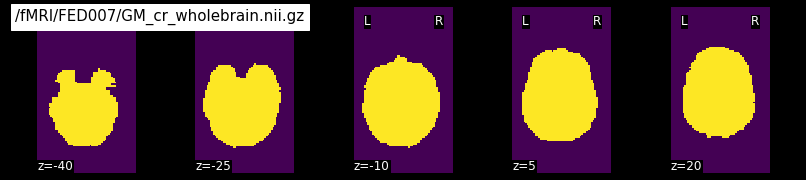

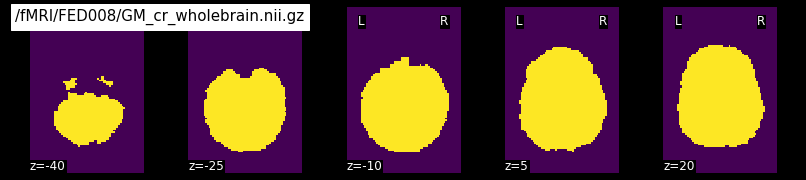

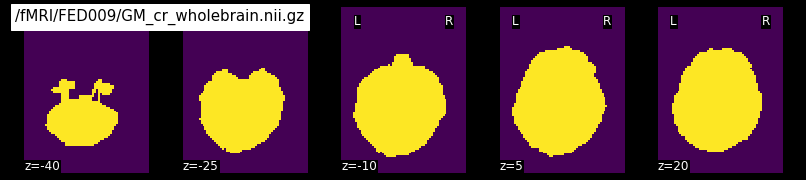

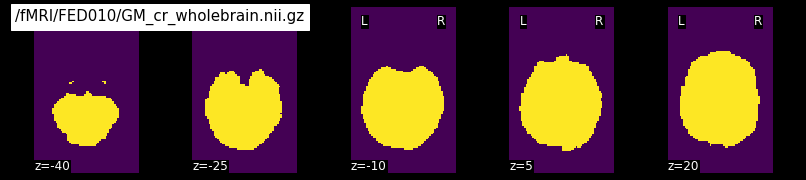

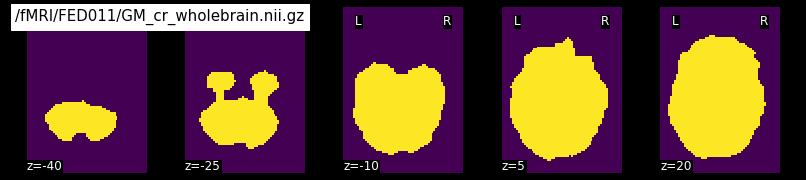

...

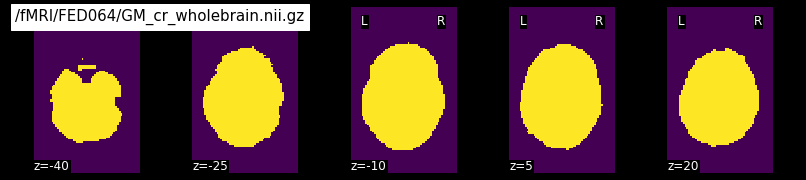

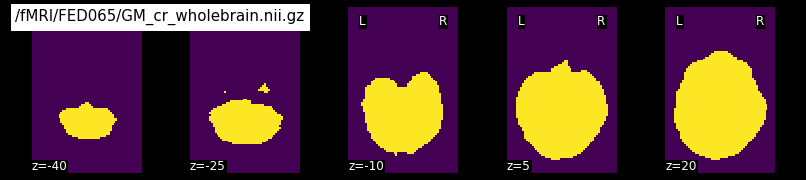

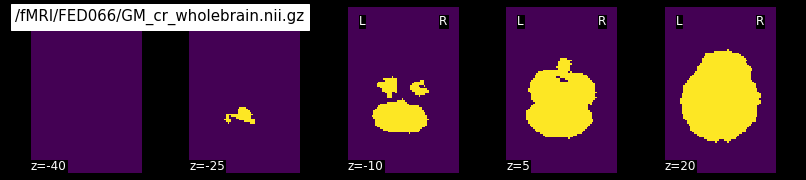

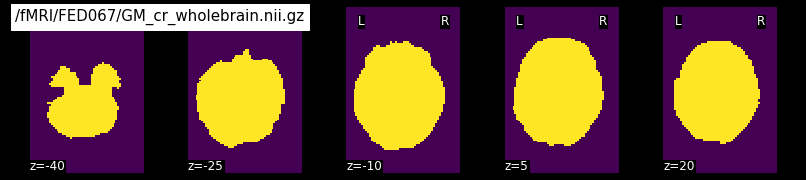

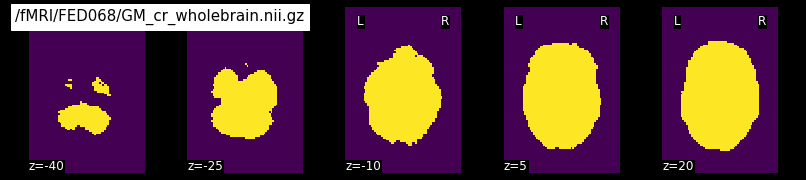

In [18]:
# plot the wbmasks to make sure they're good
for img in cr_wbmasks:
    figure = ni_plt.plot_epi(img, title=f"{img}", display_mode='z', cut_coords=range(-40, 21, 15),
                    cmap=plt.cm.viridis)
    # print the figure to the screen
    plt.show(figure)
    # close the figure to prevent memory overload
    figure.close()

II. Pre-Smooth: Calculate median values and usans for use with FSL's SUSAN algorithm

In [19]:
# determine the median value of the coregistered unmasked functional runs using the wholebrain masks
# write loop that executes only if the required files exist and are complete
if len(coregistered) == len(FEDs) and len(cr_wbmasks) == len(FEDs):
    for img, mask in zip(coregistered, cr_wbmasks):
        medianval = pe.Node(fsl.ImageStats(), name="medianval")
        medianval.inputs.in_file = img
        medianval.inputs.mask_file = mask
        medianval.inputs.op_string = "-k %s -p 50"
        # run it
        res = medianval.run()
        # insert the median intensity value into the parameter dict for the present subject
        data[img.rsplit('/', 2)[1]]["parameters"]["medianint"] = res.outputs.out_stat


elif (len(coregistered) < len(FEDs) and len(coregistered) > 0
      and len(cr_wbmasks) < len(FEDs) and len(cr_wbmasks) > 0):
    print("There aren't enough coregistered files and wholebrain masks. \n",
          f"Only {len(FEDs) - len(coregistered)} files and {len(FEDs) - len(cr_wbmasks)} masks were found.")


elif len(coregistered) == 0 and len(cr_wbmasks) == 0:
    print('Post-Coregistration mask building not yet performed.')

else:
    print("Something weird's wrong with the files here ... Check.")

210427-11:52:15,855 nipype.workflow INFO:
	 [Node] Setting-up "medianval" in "/tmp/tmpp1_g_qby/medianval".
210427-11:52:15,858 nipype.workflow INFO:
	 [Node] Running "medianval" ("nipype.interfaces.fsl.utils.ImageStats"), a CommandLine Interface with command:
fslstats /fMRI/FED007/FMRI_mc-bet-cr.nii.gz -k /fMRI/FED007/GM_cr_wholebrain.nii.gz -p 50 
210427-11:52:21,203 nipype.workflow INFO:
	 [Node] Finished "medianval".
210427-11:52:21,206 nipype.workflow INFO:
	 [Node] Setting-up "medianval" in "/tmp/tmp3ly6olvp/medianval".
210427-11:52:21,210 nipype.workflow INFO:
	 [Node] Running "medianval" ("nipype.interfaces.fsl.utils.ImageStats"), a CommandLine Interface with command:
fslstats /fMRI/FED008/FMRI_mc-bet-cr.nii.gz -k /fMRI/FED008/GM_cr_wholebrain.nii.gz -p 50 
210427-11:52:26,778 nipype.workflow INFO:
	 [Node] Finished "medianval".
210427-11:52:26,781 nipype.workflow INFO:
	 [Node] Setting-up "medianval" in "/tmp/tmp5cy3xkfi/medianval".
210427-11:52:26,785 nipype.workflow INFO:
	 [

In [20]:
# merge mean images and median values into tuples = usans for each subject
# define input files
medianvals = [data[sub]["parameters"]["medianint"]
              for sub in FEDs]  # don't sort^^

# write loop that executes only if the required files exist and are complete
if len(coregistered_mean) == len(FEDs) and len(medianvals) == len(FEDs):
    for mean, median in zip(coregistered_mean, medianvals):
        data[mean.rsplit('/', 2)[1]]["parameters"]["usantuple"] = [mean, median]

elif (len(coregistered_mean) < len(FEDs) and len(coregistered_mean) > 0
      and len(medianvals) < len(FEDs) and len(medianvals) > 0):
    print("There aren't enough motion corrected robust intensity mean files and median intensity values. \n",
          f"Only {len(FEDs) - len(coregistered_mean)} files and {len(FEDs) - len(medianvals)} values were found.")

elif len(medianvals) == 0 and len(coregistered_mean) == 0:
    print('Median value calculations and averaging the coregistered has not yet been performed.',
          'Both lists are empty.')

else:
    print("Something weird's wrong with the files here ... Check.")

In [21]:
# control the brightness thresholds per subject
for fed, med in zip(FEDs, medianvals):
    print(f"{fed} has a brightness threshold of {0.75 * med}")

FED007 has a brightness threshold of 509.313309
FED008 has a brightness threshold of 524.030319
FED009 has a brightness threshold of 575.80810575
FED010 has a brightness threshold of 575.59574925
FED011 has a brightness threshold of 509.47535700000003
FED012 has a brightness threshold of 528.66435225
FED013 has a brightness threshold of 486.46577475000004
FED014 has a brightness threshold of 643.884201
FED015 has a brightness threshold of 507.635925
FED016 has a brightness threshold of 524.503143
FED017 has a brightness threshold of 495.12300074999996
FED018 has a brightness threshold of 519.11457825
FED019 has a brightness threshold of 558.66407775
FED020 has a brightness threshold of 531.6103364999999
FED021 has a brightness threshold of 398.475723
FED022 has a brightness threshold of 507.95571899999993
FED023 has a brightness threshold of 516.75471525
FED024 has a brightness threshold of 598.8880005
FED025 has a brightness threshold of 540.1484069999999
FED026 has a brightness thres

Spatial smoothing \
Start the smoothing small (9mm FWHM) to meet RFT - increase if you get the feeling that the significant area size is large in general

In [22]:
# define function to get the brightness threshold for SUSAN at 75% median intensity (FSL FEAT default)
def getbtthresh(medianval):
    return 0.75 * medianval

# define a function to get the usans (brightness threshold plus mean functional mask) for SUSAN
def getusans(usantuple):
    return [tuple([usantuple[0], 0.75 * usantuple[1]])]

In [23]:
# smooth the data using SUSAN
for img, mask in zip(coregistered, cr_wbmasks):
    # explore different degrees of smoothing
    for fwhm in [9.0, 10.0]:
        smooth = pe.Node(fsl.SUSAN(), name= "smooth")
        smooth.inputs.in_file = img
        smooth.inputs.out_file = f"{img.rsplit('.', 2)[0]}-s{str(fwhm).split('.', 1)[0]}.nii.gz"
        smooth.inputs.brightness_threshold = getbtthresh(data[img.rsplit('/', 2)[1]]["parameters"]["medianint"])
        smooth.inputs.usans = getusans(data[img.rsplit('/', 2)[1]]["parameters"]["usantuple"])
        smooth.inputs.fwhm = fwhm
        # run it
        res = smooth.run()
        # print it
        print(res.outputs)

# update files
update_files(collect_files())

210427-11:58:43,924 nipype.workflow INFO:
	 [Node] Setting-up "smooth" in "/tmp/tmpvclc0dw9/smooth".
210427-11:58:43,929 nipype.workflow INFO:
	 [Node] Running "smooth" ("nipype.interfaces.fsl.preprocess.SUSAN"), a CommandLine Interface with command:
susan /fMRI/FED007/FMRI_mc-bet-cr.nii.gz 509.3133090000 3.8219481013 3 1 1 /fMRI/FED007/FMRI_mc-bet-cr_mean.nii.gz 509.3133090000 /fMRI/FED007/FMRI_mc-bet-cr-s9.nii.gz
210427-12:00:47,457 nipype.workflow INFO:
	 [Node] Finished "smooth".

smoothed_file = /fMRI/FED007/FMRI_mc-bet-cr-s9.nii.gz

210427-12:00:47,460 nipype.workflow INFO:
	 [Node] Setting-up "smooth" in "/tmp/tmpzq_2ssc4/smooth".
210427-12:00:47,465 nipype.workflow INFO:
	 [Node] Running "smooth" ("nipype.interfaces.fsl.preprocess.SUSAN"), a CommandLine Interface with command:
susan /fMRI/FED007/FMRI_mc-bet-cr.nii.gz 509.3133090000 4.2466090014 3 1 1 /fMRI/FED007/FMRI_mc-bet-cr_mean.nii.gz 509.3133090000 /fMRI/FED007/FMRI_mc-bet-cr-s10.nii.gz
210427-12:02:50,68 nipype.workflow 

In [24]:
# mask the smoothed images with the newly generated whole brain masks
# define input files
smoothed = sorted([i for sub in FEDs
                  for i in data[sub]["files"]
                  if re.match(r'.*(FMRI).*(?<=s9).nii.gz$', i)])  # will choose the 9mm smoothing for now^^

for img, mask in zip(smoothed, cr_wbmasks):
    maskcoregistered = pe.Node(fsl.ImageMaths(), name="masksmoothed")
    maskcoregistered.inputs.in_file = img
    maskcoregistered.inputs.in_file2 = mask
    maskcoregistered.inputs.out_file = f"{img.rsplit('.',2)[0]}-m.nii.gz"
    maskcoregistered.inputs.op_string = "-mas"
    # run it
    res = maskcoregistered.run()
    # print the results
    print(res.outputs)

# update files
update_files(collect_files())

210427-16:27:33,850 nipype.workflow INFO:
	 [Node] Setting-up "masksmoothed" in "/tmp/tmpt9xf0crm/masksmoothed".
210427-16:27:33,854 nipype.workflow INFO:
	 [Node] Running "masksmoothed" ("nipype.interfaces.fsl.utils.ImageMaths"), a CommandLine Interface with command:
fslmaths /fMRI/FED007/FMRI_mc-bet-cr-s9.nii.gz -mas /fMRI/FED007/GM_cr_wholebrain.nii.gz /fMRI/FED007/FMRI_mc-bet-cr-s9-m.nii.gz
210427-16:27:44,466 nipype.workflow INFO:
	 [Node] Finished "masksmoothed".

out_file = /fMRI/FED007/FMRI_mc-bet-cr-s9-m.nii.gz

210427-16:27:44,469 nipype.workflow INFO:
	 [Node] Setting-up "masksmoothed" in "/tmp/tmpilsosdb7/masksmoothed".
210427-16:27:44,472 nipype.workflow INFO:
	 [Node] Running "masksmoothed" ("nipype.interfaces.fsl.utils.ImageMaths"), a CommandLine Interface with command:
fslmaths /fMRI/FED008/FMRI_mc-bet-cr-s9.nii.gz -mas /fMRI/FED008/GM_cr_wholebrain.nii.gz /fMRI/FED008/FMRI_mc-bet-cr-s9-m.nii.gz
210427-16:27:55,205 nipype.workflow INFO:
	 [Node] Finished "masksmoothed".

# QC

Print cut from each functional at each successive tage of pre-processing:

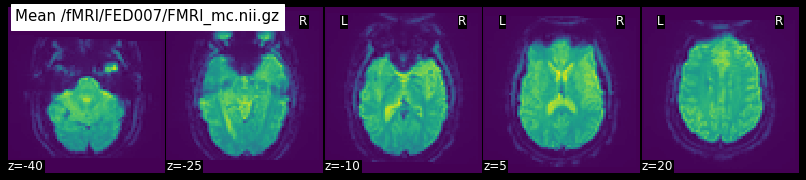

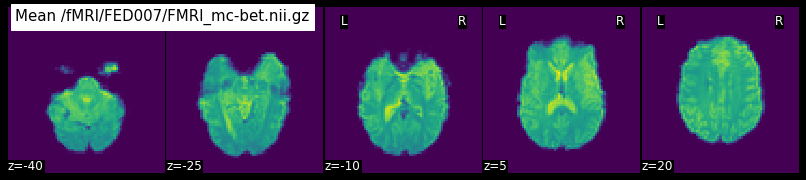

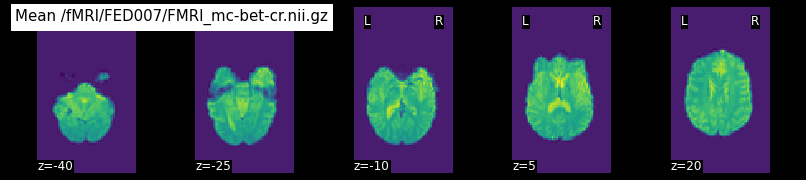

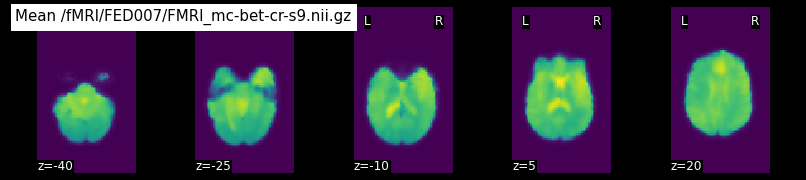

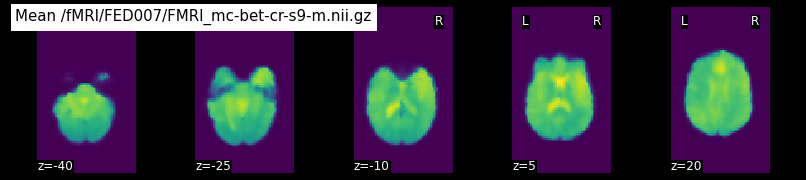

...

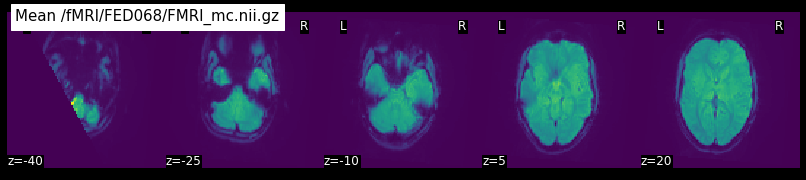

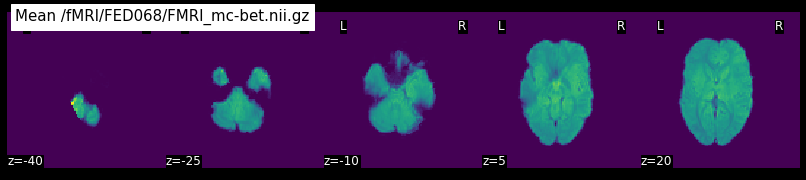

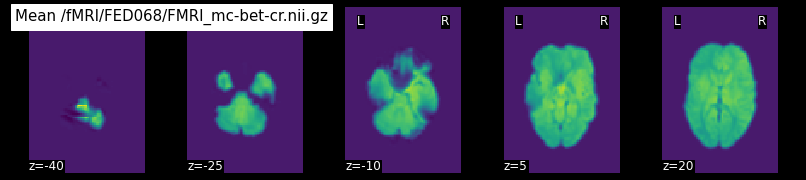

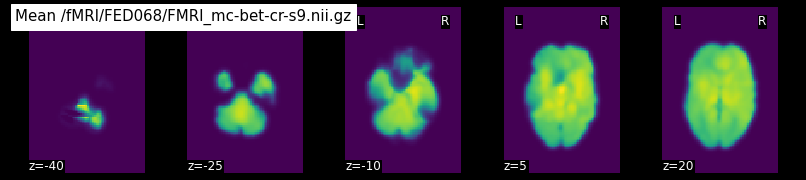

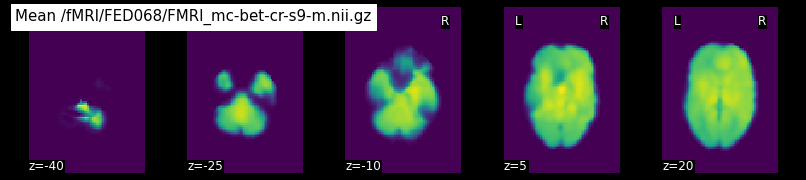

In [25]:
for sub, subdir in zip(FEDs, FED_dirs):
    # loop over each pre-processing step
    # define relevant prepped files sorted by length of the prep string
    prepped = sorted([i for i in data[sub]["files"]
                      if re.match(r'.*(FMRI_).*(?<!(-s10|-s11|-s12|mask|mean|size|rlay))(.nii|.nii.gz)$', i)],
                     key=lambda i: i.split('.', 1)[0])
    # compute the mean functional to plot
    for img in prepped:
        mean = ni_img.mean_img(img)
        figure = ni_plt.plot_epi(mean, title=f"Mean {img}", display_mode='z', cut_coords=range(-40, 21, 15),
                        cmap=plt.cm.viridis)
        # print the figure to the screen
        plt.show(figure)
        # close the figure to prevent memory overload
        figure.close()

Check rapidart thresholds with corresponding outlier numbers and think about their suitability

Rapidart's global threshold level for spm_global masking -> needed, advisable, suitable?